In [2]:
import pandas as pd
import matplotlib.pyplot as plt
import re
import time
import warnings
import numpy as np
from nltk.corpus import stopwords
from sklearn.preprocessing import normalize
from sklearn.feature_extraction.text import CountVectorizer
from sklearn.feature_extraction.text import TfidfVectorizer
warnings.filterwarnings("ignore")
import sys
import os 
import pandas as pd
import numpy as np
from tqdm import tqdm
import spacy

In [16]:
df = pd.read_csv('final_features.csv')

In [72]:
df.head(10)

,Unnamed: 0,id,is_duplicate,cwc_min,cwc_max,csc_min,csc_max,ctc_min,ctc_max,last_word_eq,...,86_y,87_y,88_y,89_y,90_y,91_y,92_y,93_y,94_y,95_y
0,0,0,0,0.999980,0.833319,0.999983,0.999983,0.916659,0.785709,0.0,...,23.793560,-20.588538,-25.390728,12.380474,-19.671300,16.618838,30.438979,43.384339,5.521896,2.243536
1,1,1,0,0.799984,0.399996,0.749981,0.599988,0.699993,0.466664,0.0,...,68.032528,1.352752,-25.395078,-7.580498,-23.430201,3.710806,1.435839,44.218947,11.410592,22.943373
2,2,2,0,0.399992,0.333328,0.399992,0.249997,0.399996,0.285712,0.0,...,-10.696379,-35.324791,-20.233565,40.031800,-22.515539,12.892510,0.084740,21.583779,24.523905,-7.576786
3,3,3,0,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.0,...,6.891580,-21.247972,0.394724,41.386917,-9.613216,18.265161,-1.723291,1.429064,18.121417,18.179006
4,4,4,0,0.399992,0.199998,0.999950,0.666644,0.571420,0.307690,0.0,...,17.671461,-11.538394,-11.433049,14.088319,-32.659020,6.244056,20.535059,17.647714,12.484857,-12.859808
5,5,5,1,0.666656,0.571420,0.888879,0.799992,0.705878,0.705878,1.0,...,23.299828,23.817801,-24.890131,-56.927054,-2.215075,52.634251,-14.493708,22.898442,-15.336361,47.136550
6,6,6,0,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.0,...,0.297116,-13.021200,-4.408648,28.517062,15.301205,81.300556,28.479334,20.833950,-7.543520,38.733711
7,7,7,1,0.499975,0.499975,0.599988,0.428565,0.571420,0.444440,1.0,...,-6.858936,-2.562763,-26.010073,-2.747263,-13.853889,12.561865,22.785699,10.310986,2.117570,-11.532683
8,8,8,0,0.999950,0.499988,0.999975,0.799984,0.857131,0.749991,0.0,...,4.913372,10.327860,1.367509,-7.591696,-18.043575,17.784507,4.346496,-14.448122,18.443290,-5.266914
9,9,9,0,0.599988,0.499992,0.333322,0.249994,0.444440,0.444440,0.0,...,-3.545054,-6.024160,-25.804716,13.249143,-12.164566,-4.021057,-2.997817,16.462615,13.259449,5.882133


In [18]:
dfx = df.iloc[:,30:30+96]
dfy = df.iloc[:,30+96:]

In [19]:
dfx.head()

,0_x,1_x,2_x,3_x,4_x,5_x,6_x,7_x,8_x,9_x,...,86_x,87_x,88_x,89_x,90_x,91_x,92_x,93_x,94_x,95_x
0,18.807843,41.964926,33.081681,4.244238,43.027659,-10.013383,-10.744927,-11.815859,5.588288,1.115522,...,20.576247,-21.568797,-24.228453,14.157065,-16.261115,25.544021,25.480808,39.165071,3.834185,9.871860
1,-23.079738,14.342906,-0.805506,-19.245326,8.865776,-9.310454,-16.653165,-13.512745,3.500085,-3.910091,...,53.702352,13.131150,-22.455495,-54.181957,0.183353,-3.724258,-12.677888,19.355100,11.162901,19.004885
2,-0.112307,18.152627,17.287431,23.381115,25.388425,-6.092771,-20.567529,-15.121522,-2.940608,16.324171,...,-2.378785,-2.544791,-10.461190,16.518055,-21.963829,22.504434,2.132555,8.428122,27.520017,-22.875334
3,-22.978012,3.542216,-21.203833,6.316206,11.723298,11.653462,-29.423875,2.754801,-17.613957,-12.570249,...,-25.697054,-17.881601,-30.913518,1.010653,8.655211,22.253350,-7.253639,18.266633,51.872220,6.351798
4,47.606715,76.045652,-16.103146,25.784890,4.649403,-14.228687,-42.204426,32.545716,4.067297,-16.961617,...,22.576464,-35.968549,-19.760356,-52.964732,-60.509826,20.788706,45.909070,44.480312,-28.241497,18.110361


In [20]:
dfy.head()

,0_y,1_y,2_y,3_y,4_y,5_y,6_y,7_y,8_y,9_y,...,86_y,87_y,88_y,89_y,90_y,91_y,92_y,93_y,94_y,95_y
0,18.710824,37.375986,45.405516,5.426995,33.751131,-3.253420,-4.959911,-13.442803,3.905695,4.777382,...,23.793560,-20.588538,-25.390728,12.380474,-19.671300,16.618838,30.438979,43.384339,5.521896,2.243536
1,-13.239171,38.161040,31.628311,-9.844968,17.468515,-19.613922,-16.775893,1.972479,-5.051891,6.606223,...,68.032528,1.352752,-25.395078,-7.580498,-23.430201,3.710806,1.435839,44.218947,11.410592,22.943373
2,1.774256,41.910379,11.486097,-2.761912,31.372257,-0.054157,-33.715000,9.834838,-8.615697,-18.969312,...,-10.696379,-35.324791,-20.233565,40.031800,-22.515539,12.892510,0.084740,21.583779,24.523905,-7.576786
3,5.639871,15.257331,8.393493,34.085459,17.597781,2.442303,-16.274006,0.360628,-10.255298,-14.794721,...,6.891580,-21.247972,0.394724,41.386917,-9.613216,18.265161,-1.723291,1.429064,18.121417,18.179006
4,9.878437,30.031709,29.496887,0.223323,16.194255,7.182570,-18.419677,6.949175,11.067374,7.980174,...,17.671461,-11.538394,-11.433049,14.088319,-32.659020,6.244056,20.535059,17.647714,12.484857,-12.859808


In [21]:
dfx.shape

(404290, 96)

In [23]:
from scipy import spatial

In [24]:
cos = {}
for i in range(len(dfx)):
    x = list(dfx.iloc[i,:])
    y = list(dfy.iloc[i,:])
    cosine_similarity = 1 - spatial.distance.cosine(x, y)
    cos.append(cosine_similarity)
print(cos)

[0.9706069544158148, 0.7639183772245646, 0.6418749348932141, 0.2027221578725913, 0.5196835085352053, 0.6626650727440417, 0.25437647991510515, 0.9109501964401207, 0.8372683342570001, 0.7536646489958764, 0.6476256854829339, 0.6979899896349129, 0.9065890634145735, 0.9504274069017756, 0.990104660600817, 0.6113952375633497, 0.810458431841947, 0.5735367049676725, 0.5889252395692448, 0.8491736281320897, 0.5054839523528648, 0.7219655523995863, 0.45719403437096595, 0.2628310763572992, 0.5230148718968066, 0.9135355515701064, 0.860266396859659, 0.623884928213248, 0.8781911027200715, 0.678653786633037, 0.47699123121609344, 0.5903815069615006, 0.8139199124707739, 0.48707066613936467, 0.7449375499210543, 0.5570291485752408, 0.8247002761787222, 0.6622093569031715, 0.5960056844259034, 0.4699614985498306, 0.5021435696189178, 0.9072200189865226, 0.9986096412667796, 0.7334317113542899, 0.9105901783505828, 0.6656368666148141, 0.4369892454702222, 0.36751002295816815, 0.7919763753385318, 0.7662218568361392,

In [30]:
dup = list(df['is_duplicate'])

In [45]:
df.head()

,Unnamed: 0,id,is_duplicate,cwc_min,cwc_max,csc_min,csc_max,ctc_min,ctc_max,last_word_eq,...,86_y,87_y,88_y,89_y,90_y,91_y,92_y,93_y,94_y,95_y
0,0,0,0,0.999980,0.833319,0.999983,0.999983,0.916659,0.785709,0.0,...,23.793560,-20.588538,-25.390728,12.380474,-19.671300,16.618838,30.438979,43.384339,5.521896,2.243536
1,1,1,0,0.799984,0.399996,0.749981,0.599988,0.699993,0.466664,0.0,...,68.032528,1.352752,-25.395078,-7.580498,-23.430201,3.710806,1.435839,44.218947,11.410592,22.943373
2,2,2,0,0.399992,0.333328,0.399992,0.249997,0.399996,0.285712,0.0,...,-10.696379,-35.324791,-20.233565,40.031800,-22.515539,12.892510,0.084740,21.583779,24.523905,-7.576786
3,3,3,0,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.0,...,6.891580,-21.247972,0.394724,41.386917,-9.613216,18.265161,-1.723291,1.429064,18.121417,18.179006
4,4,4,0,0.399992,0.199998,0.999950,0.666644,0.571420,0.307690,0.0,...,17.671461,-11.538394,-11.433049,14.088319,-32.659020,6.244056,20.535059,17.647714,12.484857,-12.859808


In [69]:
orig = {}
cos = {}
for i in range(len(df)):
    x = list(df.iloc[i,30:30+96])
    y = list(df.iloc[i,30+96:])
    cosine_similarity = 1 - spatial.distance.cosine(x, y)
    cos[i] = cosine_similarity
    orig[i] = df.iloc[i,2]


In [71]:
for i in orig:
    print(orig[i],cos[i])

0 0.9706069544158148
0 0.7639183772245646
0 0.6418749348932141
0 0.2027221578725913
0 0.5196835085352053
1 0.6626650727440417
0 0.25437647991510515
1 0.9109501964401207
0 0.8372683342570001
0 0.7536646489958764
0 0.6476256854829339
1 0.6979899896349129
1 0.9065890634145735
1 0.9504274069017756
0 0.990104660600817
1 0.6113952375633497
1 0.810458431841947
0 0.5735367049676725
1 0.5889252395692448
0 0.8491736281320897
1 0.5054839523528648
0 0.7219655523995863
0 0.45719403437096595
0 0.2628310763572992
0 0.5230148718968066
0 0.9135355515701064
0 0.860266396859659
0 0.623884928213248
0 0.8781911027200715
1 0.678653786633037
0 0.47699123121609344
1 0.5903815069615006
1 0.8139199124707739
0 0.48707066613936467
0 0.7449375499210543
0 0.5570291485752408
0 0.8247002761787222
0 0.6622093569031715
1 0.5960056844259034
0 0.4699614985498306
0 0.5021435696189178
0 0.9072200189865226
0 0.9986096412667796
0 0.7334317113542899
0 0.9105901783505828
0 0.6656368666148141
0 0.4369892454702222
0 0.3675100229

In [74]:
df.drop(df.index[0], inplace=True)
y_true = df['is_duplicate']
df.drop(['Unnamed: 0', 'id','is_duplicate'], axis=1, inplace=True)

In [75]:
cols = list(df.columns)
for i in cols:
    df[i] = df[i].apply(pd.to_numeric)
    print(i)

cwc_min
cwc_max
csc_min
csc_max
ctc_min
ctc_max
last_word_eq
first_word_eq
abs_len_diff
mean_len
token_set_ratio
token_sort_ratio
fuzz_ratio
fuzz_partial_ratio
longest_substr_ratio
Unnamed: 0.1
freq_qid1
freq_qid2
q1len
q2len
q1_n_words
q2_n_words
Common_words
words_set
word_share
freq_q1+q2
freq_q1-q2
0_x
1_x
2_x
3_x
4_x
5_x
6_x
7_x
8_x
9_x
10_x
11_x
12_x
13_x
14_x
15_x
16_x
17_x
18_x
19_x
20_x
21_x
22_x
23_x
24_x
25_x
26_x
27_x
28_x
29_x
30_x
31_x
32_x
33_x
34_x
35_x
36_x
37_x
38_x
39_x
40_x
41_x
42_x
43_x
44_x
45_x
46_x
47_x
48_x
49_x
50_x
51_x
52_x
53_x
54_x
55_x
56_x
57_x
58_x
59_x
60_x
61_x
62_x
63_x
64_x
65_x
66_x
67_x
68_x
69_x
70_x
71_x
72_x
73_x
74_x
75_x
76_x
77_x
78_x
79_x
80_x
81_x
82_x
83_x
84_x
85_x
86_x
87_x
88_x
89_x
90_x
91_x
92_x
93_x
94_x
95_x
0_y
1_y
2_y
3_y
4_y
5_y
6_y
7_y
8_y
9_y
10_y
11_y
12_y
13_y
14_y
15_y
16_y
17_y
18_y
19_y
20_y
21_y
22_y
23_y
24_y
25_y
26_y
27_y
28_y
29_y
30_y
31_y
32_y
33_y
34_y
35_y
36_y
37_y
38_y
39_y
40_y
41_y
42_y
43_y
44_y
45_y
46_y
4

In [76]:
y_true = list(map(int, y_true.values))

In [77]:
from sklearn.model_selection import train_test_split
X_train,X_test, y_train, y_test = train_test_split(df, y_true, stratify=y_true, test_size=0.3)

In [78]:
print("Number of data points in train data :",X_train.shape)
print("Number of data points in test data :",X_test.shape)

Number of data points in train data : (283001, 219)
Number of data points in test data : (121287, 219)


In [101]:
from collections import Counter
print("-"*10, "Distribution of output variable in train data", "-"*10)
train_distr = Counter(y_train)
train_len = len(y_train)
print("Class 0: ",int(train_distr[0])/train_len,"Class 1: ", int(train_distr[1])/train_len)
print("-"*10, "Distribution of output variable in test data", "-"*10)
test_distr = Counter(y_test)
test_len = len(y_test)
print("Class 0: ",int(test_distr[0])/test_len, "Class 1: ",int(test_distr[1])/test_len)

---------- Distribution of output variable in train data ----------
Class 0:  0.6307998911664623 Class 1:  0.3692001088335377
---------- Distribution of output variable in test data ----------
Class 0:  0.6308013224830361 Class 1:  0.3691986775169639


In [81]:
from sklearn.metrics import accuracy_score, log_loss

In [82]:
from sklearn.metrics import confusion_matrix
import seaborn as sns
def plot_confusion_matrix(test_y, predict_y):
    C = confusion_matrix(test_y, predict_y)
    A =(((C.T)/(C.sum(axis=1))).T)
    B =(C/C.sum(axis=0))
    plt.figure(figsize=(20,4))
    
    labels = [1,2]
    cmap=sns.light_palette("blue")
    plt.subplot(1, 3, 1)
    sns.heatmap(C, annot=True, cmap=cmap, fmt=".3f", xticklabels=labels, yticklabels=labels)
    plt.xlabel('Predicted Class')
    plt.ylabel('Original Class')
    plt.title("Confusion matrix")
    
    plt.subplot(1, 3, 2)
    sns.heatmap(B, annot=True, cmap=cmap, fmt=".3f", xticklabels=labels, yticklabels=labels)
    plt.xlabel('Predicted Class')
    plt.ylabel('Original Class')
    plt.title("Precision matrix")
    
    plt.subplot(1, 3, 3)
    sns.heatmap(A, annot=True, cmap=cmap, fmt=".3f", xticklabels=labels, yticklabels=labels)
    plt.xlabel('Predicted Class')
    plt.ylabel('Original Class')
    plt.title("Recall matrix")
    
    plt.show()

Log loss on Test Data using Random Model 0.8846128901159691


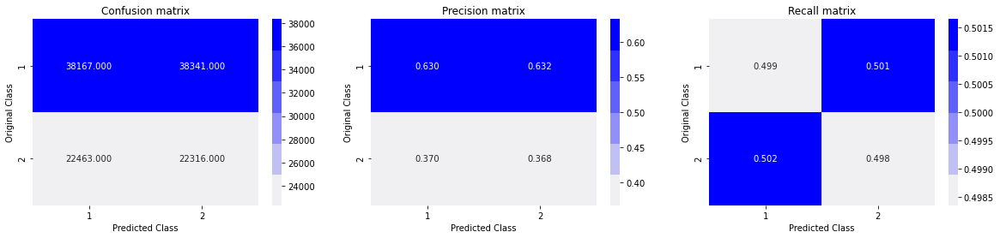

In [83]:
test_len = len(X_test)
predicted_y = np.zeros((test_len,2))
for i in range(test_len):
    rand_probs = np.random.rand(1,2)
    predicted_y[i] = ((rand_probs/sum(sum(rand_probs)))[0])
print("Log loss on Test Data using Random Model",log_loss(y_test, predicted_y, eps=1e-15))

predicted_y =np.argmax(predicted_y, axis=1)
plot_confusion_matrix(y_test, predicted_y)

In [93]:
from xgboost import XGBClassifier
classifier = XGBClassifier()
classifier.fit(X_train, y_train)

[18:40:57] WARNING: C:/Users/Administrator/workspace/xgboost-win64_release_1.5.1/src/learner.cc:1115: Starting in XGBoost 1.3.0, the default evaluation metric used with the objective 'binary:logistic' was changed from 'error' to 'logloss'. Explicitly set eval_metric if you'd like to restore the old behavior.


XGBClassifier(base_score=0.5, booster='gbtree', colsample_bylevel=1,
              colsample_bynode=1, colsample_bytree=1, enable_categorical=False,
              gamma=0, gpu_id=-1, importance_type=None,
              interaction_constraints='', learning_rate=0.300000012,
              max_delta_step=0, max_depth=6, min_child_weight=1, missing=nan,
              monotone_constraints='()', n_estimators=100, n_jobs=8,
              num_parallel_tree=1, predictor='auto', random_state=0,
              reg_alpha=0, reg_lambda=1, scale_pos_weight=1, subsample=1,
              tree_method='exact', validate_parameters=1, verbosity=None)

In [94]:
from sklearn.model_selection import cross_val_score
accuracies = cross_val_score(estimator = classifier, X = X_train, y = y_train, cv = 10)
print("Accuracy: {:.2f} %".format(accuracies.mean()*100))
print("Standard Deviation: {:.2f} %".format(accuracies.std()*100))

[18:54:16] WARNING: C:/Users/Administrator/workspace/xgboost-win64_release_1.5.1/src/learner.cc:1115: Starting in XGBoost 1.3.0, the default evaluation metric used with the objective 'binary:logistic' was changed from 'error' to 'logloss'. Explicitly set eval_metric if you'd like to restore the old behavior.
[19:00:15] WARNING: C:/Users/Administrator/workspace/xgboost-win64_release_1.5.1/src/learner.cc:1115: Starting in XGBoost 1.3.0, the default evaluation metric used with the objective 'binary:logistic' was changed from 'error' to 'logloss'. Explicitly set eval_metric if you'd like to restore the old behavior.
[19:06:56] WARNING: C:/Users/Administrator/workspace/xgboost-win64_release_1.5.1/src/learner.cc:1115: Starting in XGBoost 1.3.0, the default evaluation metric used with the objective 'binary:logistic' was changed from 'error' to 'logloss'. Explicitly set eval_metric if you'd like to restore the old behavior.
[19:12:59] WARNING: C:/Users/Administrator/workspace/xgboost-win64_rel

In [95]:
predict_y = classifier.predict(X_test)

Total number of data points : 121287


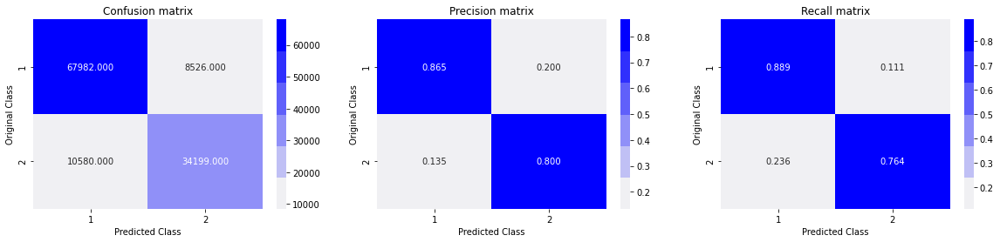

In [96]:
predicted_y =np.array(predict_y>0.5,dtype=int)
print("Total number of data points :", len(predicted_y))
plot_confusion_matrix(y_test, predicted_y)

## Analysis

#### Non_duplicates correctly classified as Non_duplicates = 88%

#### Duplicates correctly classified as duplicatess = 74%